<a href="https://colab.research.google.com/github/asim5800/ZNT/blob/main/ZNT_HW.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>


#**Zenatix Solutions Careers** 
Problem statement - Given  data contains power for multiple ACs at some hotel in Gurgaon. Idenitfy patterns trends.

In [12]:
#importing libraries

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import datetime
import missingno as msno
import matplotlib
import matplotlib.pylab as pylab

%matplotlib inline
matplotlib.style.use('ggplot')
sns.set_style('white')
pylab.rcParams['figure.figsize'] = 8,6
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

In [13]:
#Loading  Dataset
df= pd.read_csv('/content/drive/MyDrive/DSHW/AC_Data.csv', low_memory= False)

In [14]:
#displaying head of dataframe
df.head()

,,,.22626367188,Unnamed: 1,Unnamed: 2,Unnamed: 3,2.73477905273,Unnamed: 5,2.86076611328,Unnamed: 7,0.0,Unnamed: 9,Unnamed: 10,3.0937746582,Unnamed: 12,Unnamed: 13,Unnamed: 14,Unnamed: 15
2019-08-16 13:25:00,2.667430,0.000000,NaN,0.0,0.822600,0.0,NaN,2.855072,NaN,0.0,NaN,2.295798,1.234682,NaN,9.762806,9.244958,4.809051,7.088035
2019-08-16 13:26:00,NaN,NaN,4.261225,NaN,NaN,NaN,2.266663,NaN,2.509284,NaN,0.0,NaN,NaN,0.000000,NaN,NaN,NaN,NaN
2019-08-16 13:27:00,2.664725,0.000000,NaN,0.0,1.181897,0.0,NaN,2.967185,NaN,0.0,NaN,0.000000,4.393702,NaN,9.758023,9.155861,4.959964,7.188670
2019-08-16 13:28:00,NaN,NaN,4.189819,NaN,NaN,NaN,2.922344,NaN,2.615140,NaN,0.0,NaN,NaN,1.786671,NaN,NaN,NaN,NaN
2019-08-16 13:29:00,2.654007,0.000000,NaN,0.0,1.489375,0.0,NaN,2.973406,NaN,0.0,NaN,0.000000,4.827527,NaN,9.782461,9.211642,4.950183,7.210945


In [15]:
#checking shape of dataframe
df.shape

(65435, 16)

***Pandas reading dataframe by using date time as index so to fix this I renamed column as new dataset.***

In [16]:
#loading new dataset
df= pd.read_csv('/content/drive/MyDrive/DSHW/AC_Data_date.csv', low_memory= False)

In [17]:
#statistical description of dataset
df.describe()

,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18
count,43708.000000,43711.000000,43713.000000,43704.000000,43716.000000,43717.000000,43679.000000,43704.000000,43654.000000,43690.000000,43670.000000,43713.000000,43719.000000,43696.000000,43715.000000,43710.000000,43714.000000,43723.000000
mean,2.379368,3.868892,2.568411,2.395158,1.421699,2.518138,2.980883,2.548711,3.184382,1.538344,2.406141,2.699639,4.279893,2.917122,4.046283,2.800050,4.218979,6.462676
std,2.276782,2.545147,1.487508,1.797529,0.767218,1.655560,1.473498,1.504482,1.522291,0.685461,1.554481,1.436087,1.847168,1.454946,2.016898,1.606239,1.125491,2.319242
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,2.123263,1.706508,1.258299,0.970744,1.543779,2.190803,1.766230,2.294635,1.117139,1.591748,1.949729,3.260674,1.852981,3.023501,1.877626,3.752478,4.013579
50%,2.094330,3.791752,2.486992,2.308961,1.380183,2.665063,3.005071,2.608551,3.082134,1.504554,2.351361,2.727152,4.217381,2.787084,4.001279,2.673698,4.611434,7.131194
75%,3.661752,5.460892,3.441527,3.476123,1.870234,3.616988,3.897857,3.496358,4.096374,1.963707,3.254937,3.566744,5.379832,3.824467,5.260193,3.695294,4.958306,8.314639
max,11.194789,11.147141,8.430909,9.879500,5.495358,9.929291,9.356776,9.331506,10.026747,4.625030,10.363151,9.887306,9.796393,9.054969,10.349998,10.654430,5.950261,11.040031


In [18]:
#storing count of each columns/ AC in ascending order
series = df.count().sort_values(ascending=False)
series

DATE     87840
AC 18    43723
AC 13    43719
AC 6     43717
AC 5     43716
AC 15    43715
AC 17    43714
AC 12    43713
AC 3     43713
AC 2     43711
AC 16    43710
AC 1     43708
AC 4     43704
AC 8     43704
AC 14    43696
AC 10    43690
AC 7     43679
AC 11    43670
AC 9     43654
dtype: int64

***This clearly shows that AC 18 is mostly used as it has its kWH units entered 43723 times in dataset. AC 9 as the least used and similarly the usage statistics of other AC's as well.***  

In [19]:
#checking columns of fixed dataframe
df.columns

Index(['DATE', 'AC 1', 'AC 2', 'AC 3', 'AC 4', 'AC 5', 'AC 6', 'AC 7', 'AC 8',
       'AC 9', 'AC 10', 'AC 11', 'AC 12', 'AC 13', 'AC 14', 'AC 15', 'AC 16',
       'AC 17', 'AC 18'],
      dtype='object')

In [20]:
#displaying top 3 rows in dataset after fixing date attribute
df.head(3)

,DATE,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18
0,2019-08-01 00:00:00,7.518632,8.788315,0.0,0.0,2.617045,4.079041,2.782276,4.624447,5.222060,2.151238,1.585072,0.560373,3.142941,2.749470,5.417774,4.113460,3.305072,6.735981
1,2019-08-01 00:01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2019-08-01 00:02:00,7.426114,8.940615,0.0,0.0,2.581625,3.781231,2.529366,5.057423,5.349465,2.414715,2.168184,1.818730,3.085110,2.720484,3.302422,3.986483,3.220588,6.379500


In [21]:
#checking info of dataframe
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 87840 entries, 0 to 87839
Data columns (total 19 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   DATE    87840 non-null  object 
 1   AC 1    43708 non-null  float64
 2   AC 2    43711 non-null  float64
 3   AC 3    43713 non-null  float64
 4   AC 4    43704 non-null  float64
 5   AC 5    43716 non-null  float64
 6   AC 6    43717 non-null  float64
 7   AC 7    43679 non-null  float64
 8   AC 8    43704 non-null  float64
 9   AC 9    43654 non-null  float64
 10  AC 10   43690 non-null  float64
 11  AC 11   43670 non-null  float64
 12  AC 12   43713 non-null  float64
 13  AC 13   43719 non-null  float64
 14  AC 14   43696 non-null  float64
 15  AC 15   43715 non-null  float64
 16  AC 16   43710 non-null  float64
 17  AC 17   43714 non-null  float64
 18  AC 18   43723 non-null  float64
dtypes: float64(18), object(1)
memory usage: 12.7+ MB


In [22]:
#checking shape of dataframe
df.shape

(87840, 19)

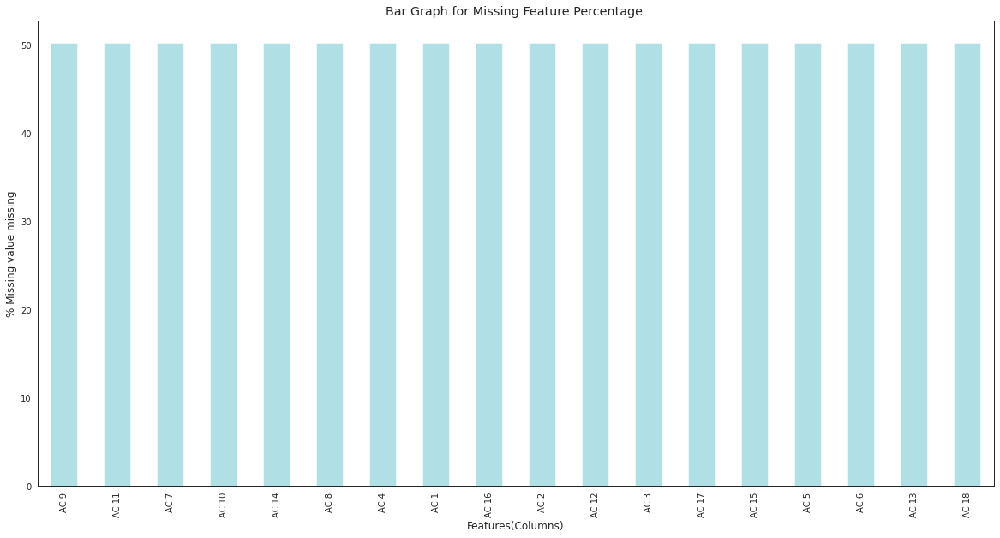

In [23]:
# Plot all the Missing Values in Decending Order
%matplotlib inline
missing_values = ((df.isna().sum())/df.shape[0])*100

missing_values.sort_values(ascending=False,inplace = True)
missing_values = missing_values.drop(missing_values[missing_values == 0].index)

color=['powderblue']

plt.figure(figsize=(20,10))
missing_values.plot.bar(color = color)
plt.xlabel('Features(Columns)')
plt.ylabel('% Missing value missing')
plt.title('Bar Graph for Missing Feature Percentage ')

plt.show()

***All AC have null values around 50%.***

In [24]:
#filling dataframe with mean of values and storing it into a new dataframe
final_df=df.fillna(df.mean())

In [25]:
#first four observations of dataframe
final_df.head(4)

,DATE,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18
0,2019-08-01 00:00:00,7.518632,8.788315,0.000000,0.000000,2.617045,4.079041,2.782276,4.624447,5.222060,2.151238,1.585072,0.560373,3.142941,2.749470,5.417774,4.113460,3.305072,6.735981
1,2019-08-01 00:01:00,2.379368,3.868892,2.568411,2.395158,1.421699,2.518138,2.980883,2.548711,3.184382,1.538344,2.406141,2.699639,4.279893,2.917122,4.046283,2.800050,4.218979,6.462676
2,2019-08-01 00:02:00,7.426114,8.940615,0.000000,0.000000,2.581625,3.781231,2.529366,5.057423,5.349465,2.414715,2.168184,1.818730,3.085110,2.720484,3.302422,3.986483,3.220588,6.379500
3,2019-08-01 00:03:00,2.379368,3.868892,2.568411,2.395158,1.421699,2.518138,2.980883,2.548711,3.184382,1.538344,2.406141,2.699639,4.279893,2.917122,4.046283,2.800050,4.218979,6.462676


In [26]:
#statistical description of dataset
final_df.describe()

,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18
count,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000
mean,2.379368,3.868892,2.568411,2.395158,1.421699,2.518138,2.980883,2.548711,3.184382,1.538344,2.406141,2.699639,4.279893,2.917122,4.046283,2.800050,4.218979,6.462676
std,1.606029,1.795393,1.049339,1.267908,0.541241,1.167942,1.039052,1.061204,1.073151,0.483420,1.096045,1.013066,1.303146,1.026169,1.422822,1.133057,0.793969,1.636260
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,2.107633,3.806399,2.495116,2.318021,1.383696,2.518138,2.980883,2.548711,3.093890,1.508463,2.358842,2.699639,4.223895,2.796519,4.010262,2.683071,4.218979,6.462676
50%,2.379368,3.868892,2.568411,2.395158,1.421699,2.518138,2.980883,2.548711,3.184382,1.538344,2.406141,2.699639,4.279893,2.917122,4.046283,2.800050,4.218979,6.462676
75%,2.379368,3.868892,2.568411,2.395158,1.421699,2.656701,2.996157,2.601819,3.184382,1.538344,2.406141,2.719761,4.279893,2.917122,4.046283,2.800050,4.607963,7.120772
max,11.194789,11.147141,8.430909,9.879500,5.495358,9.929291,9.356776,9.331506,10.026747,4.625030,10.363151,9.887306,9.796393,9.054969,10.349998,10.654430,5.950261,11.040031


In [27]:
final_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 87840 entries, 0 to 87839
Data columns (total 19 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   DATE    87840 non-null  object 
 1   AC 1    87840 non-null  float64
 2   AC 2    87840 non-null  float64
 3   AC 3    87840 non-null  float64
 4   AC 4    87840 non-null  float64
 5   AC 5    87840 non-null  float64
 6   AC 6    87840 non-null  float64
 7   AC 7    87840 non-null  float64
 8   AC 8    87840 non-null  float64
 9   AC 9    87840 non-null  float64
 10  AC 10   87840 non-null  float64
 11  AC 11   87840 non-null  float64
 12  AC 12   87840 non-null  float64
 13  AC 13   87840 non-null  float64
 14  AC 14   87840 non-null  float64
 15  AC 15   87840 non-null  float64
 16  AC 16   87840 non-null  float64
 17  AC 17   87840 non-null  float64
 18  AC 18   87840 non-null  float64
dtypes: float64(18), object(1)
memory usage: 12.7+ MB


***Null values could be filled with mean or other method but since the data entered is in power consumption units. Therefore I assume that null values can be treated as AC was turned off / not in use. So instead of filling values with mean I prefer to fill them with 0 = OFF.*** 

In [28]:
#checking columns of dataframe 
df.columns

Index(['DATE', 'AC 1', 'AC 2', 'AC 3', 'AC 4', 'AC 5', 'AC 6', 'AC 7', 'AC 8',
       'AC 9', 'AC 10', 'AC 11', 'AC 12', 'AC 13', 'AC 14', 'AC 15', 'AC 16',
       'AC 17', 'AC 18'],
      dtype='object')

In [29]:
#droping date
df1 = df.drop(["DATE"],axis=1)

#Drop All Rows with any Null/NaN
df_cl = df1.dropna()

In [30]:
#checking dataframe after removing null values
df.head()

,DATE,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18
0,2019-08-01 00:00:00,7.518632,8.788315,0.0,0.0,2.617045,4.079041,2.782276,4.624447,5.222060,2.151238,1.585072,0.560373,3.142941,2.749470,5.417774,4.113460,3.305072,6.735981
1,2019-08-01 00:01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2019-08-01 00:02:00,7.426114,8.940615,0.0,0.0,2.581625,3.781231,2.529366,5.057423,5.349465,2.414715,2.168184,1.818730,3.085110,2.720484,3.302422,3.986483,3.220588,6.379500
3,2019-08-01 00:03:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2019-08-01 00:04:00,7.052986,9.161103,0.0,0.0,2.592095,3.800127,2.332304,6.322521,3.995392,2.237114,3.345624,2.310409,3.132799,2.676861,3.539026,3.797881,3.131560,6.363475


In [31]:
#shape of cleaned dataframe
df1.shape

(87840, 18)

In [32]:
#statistical description of dataset after dropping date
df1.describe()

,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18
count,43708.000000,43711.000000,43713.000000,43704.000000,43716.000000,43717.000000,43679.000000,43704.000000,43654.000000,43690.000000,43670.000000,43713.000000,43719.000000,43696.000000,43715.000000,43710.000000,43714.000000,43723.000000
mean,2.379368,3.868892,2.568411,2.395158,1.421699,2.518138,2.980883,2.548711,3.184382,1.538344,2.406141,2.699639,4.279893,2.917122,4.046283,2.800050,4.218979,6.462676
std,2.276782,2.545147,1.487508,1.797529,0.767218,1.655560,1.473498,1.504482,1.522291,0.685461,1.554481,1.436087,1.847168,1.454946,2.016898,1.606239,1.125491,2.319242
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,2.123263,1.706508,1.258299,0.970744,1.543779,2.190803,1.766230,2.294635,1.117139,1.591748,1.949729,3.260674,1.852981,3.023501,1.877626,3.752478,4.013579
50%,2.094330,3.791752,2.486992,2.308961,1.380183,2.665063,3.005071,2.608551,3.082134,1.504554,2.351361,2.727152,4.217381,2.787084,4.001279,2.673698,4.611434,7.131194
75%,3.661752,5.460892,3.441527,3.476123,1.870234,3.616988,3.897857,3.496358,4.096374,1.963707,3.254937,3.566744,5.379832,3.824467,5.260193,3.695294,4.958306,8.314639
max,11.194789,11.147141,8.430909,9.879500,5.495358,9.929291,9.356776,9.331506,10.026747,4.625030,10.363151,9.887306,9.796393,9.054969,10.349998,10.654430,5.950261,11.040031


#**Exploratory data analysis**

**Using dataframe without date to plot distribution of values in out dataframe.**

Plotting power consumption distribution for  AC 1


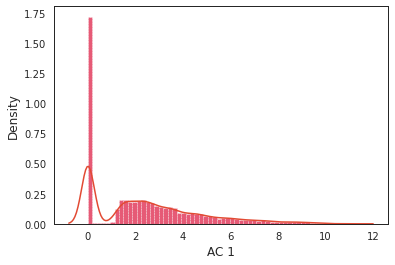

Plotting power consumption distribution for  AC 2


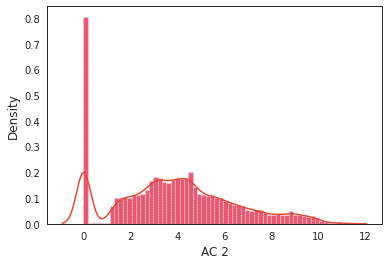

Plotting power consumption distribution for  AC 3


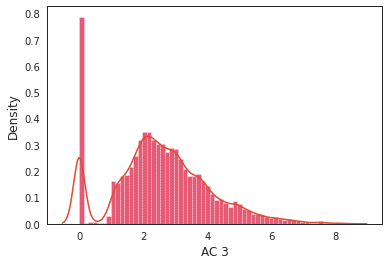

Plotting power consumption distribution for  AC 4


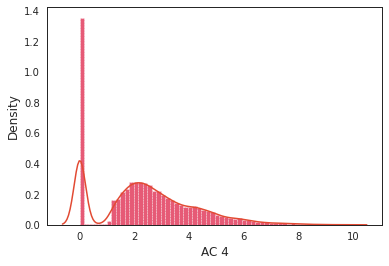

Plotting power consumption distribution for  AC 5


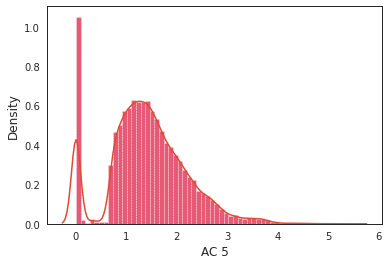

Plotting power consumption distribution for  AC 6


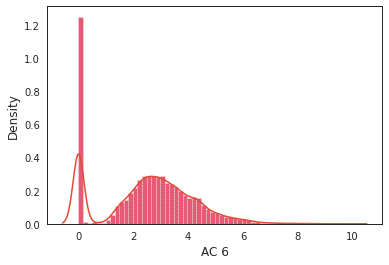

Plotting power consumption distribution for  AC 7


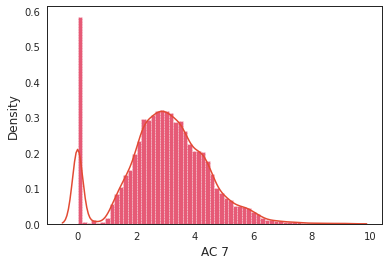

Plotting power consumption distribution for  AC 8


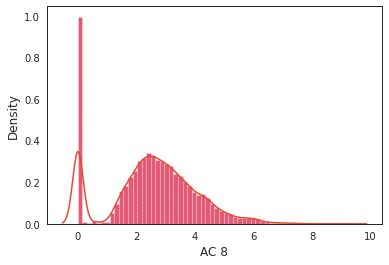

Plotting power consumption distribution for  AC 9


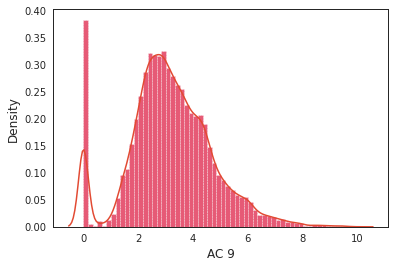

Plotting power consumption distribution for  AC 10


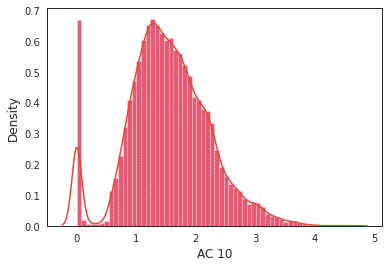

Plotting power consumption distribution for  AC 11


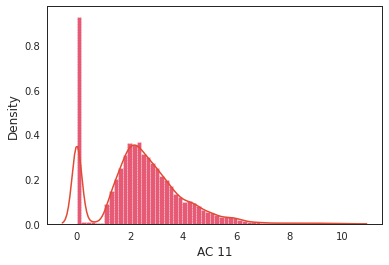

Plotting power consumption distribution for  AC 12


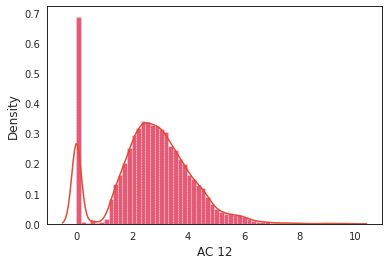

Plotting power consumption distribution for  AC 13


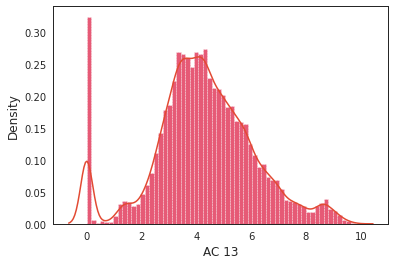

Plotting power consumption distribution for  AC 14


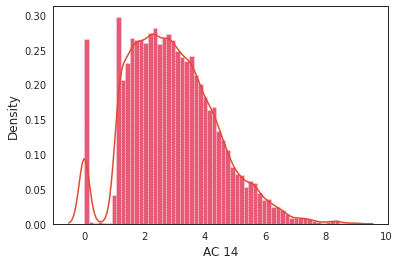

Plotting power consumption distribution for  AC 15


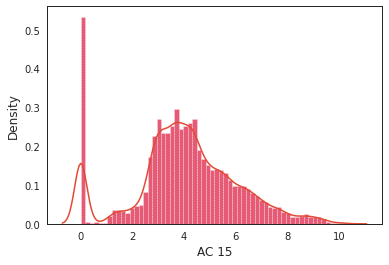

Plotting power consumption distribution for  AC 16


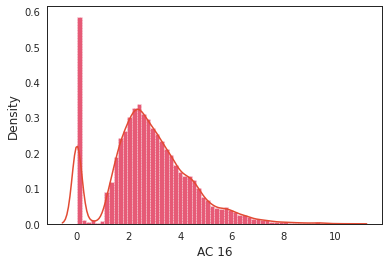

Plotting power consumption distribution for  AC 17


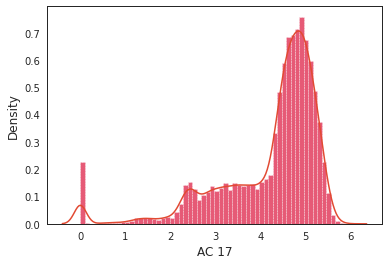

Plotting power consumption distribution for  AC 18


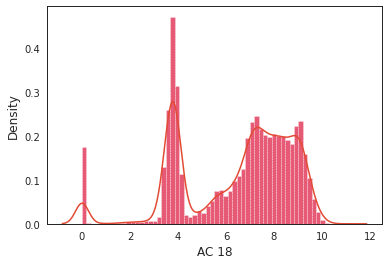

In [33]:
#plotting graph for all AC
for col in df1.columns:
    hist = sns.distplot(df1[col],
                hist_kws = {'color':'#DC143C',
                     'linestyle':'--', 'alpha':0.7}, bins=60);

    print("Plotting power consumption distribution for  {}".format(col))
    plt.show()

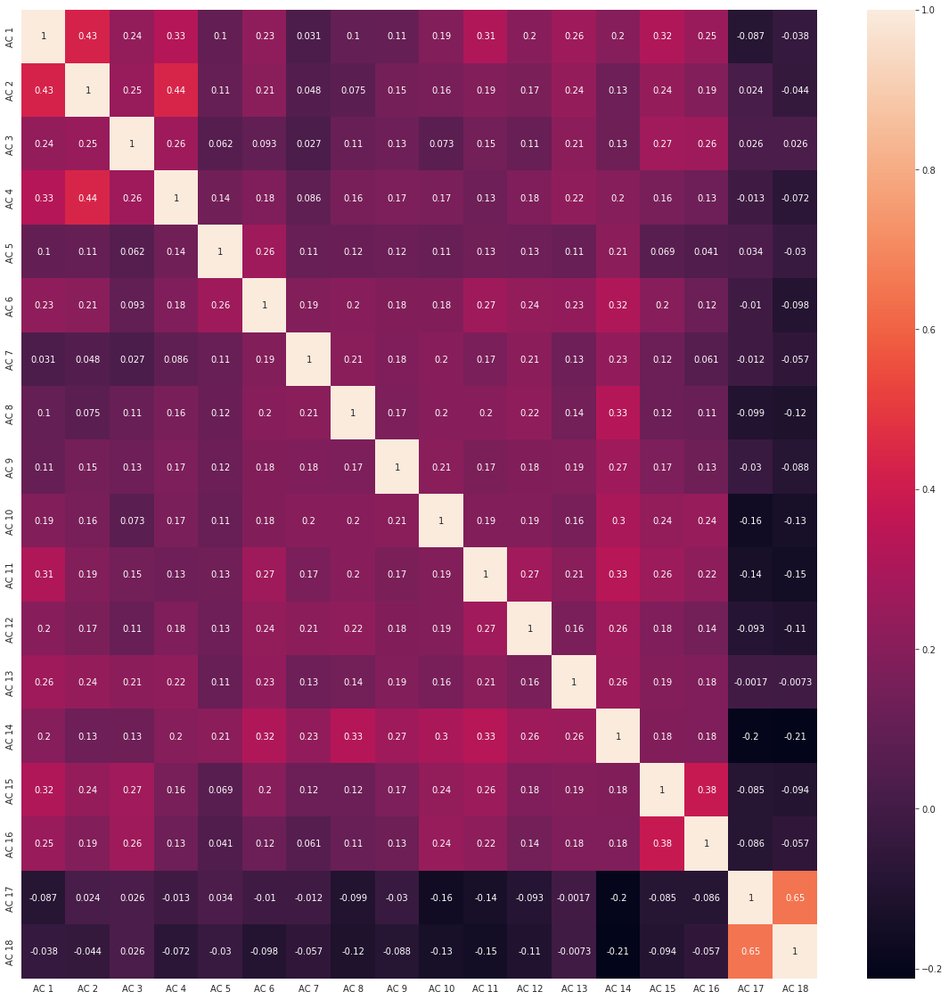

In [34]:
#plotting correlation heatmap for all AC to get more clear picture of correlation
plt.subplots(figsize=(20,20))
sns.heatmap(df1.corr(), annot=True);

**From this we can observe that AC 17 and 18 are correlated with .65 values so it could be the case like both AC are in same area/room and this is corelation after simply dropping null values, not specifically treating them.**



In [35]:
#loading our dataset again
df.head(2)

,DATE,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18
0,2019-08-01 00:00:00,7.518632,8.788315,0.0,0.0,2.617045,4.079041,2.782276,4.624447,5.22206,2.151238,1.585072,0.560373,3.142941,2.74947,5.417774,4.11346,3.305072,6.735981
1,2019-08-01 00:01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [36]:
#extracting year,month,week from date attribute
df['month'] = pd.DatetimeIndex(df['DATE']).month
df['week'] = pd.DatetimeIndex(df['DATE']).week
df['day'] = pd.DatetimeIndex(df['DATE']).day
df['hour'] = pd.DatetimeIndex(df['DATE']).hour
df['minute'] = pd.DatetimeIndex(df['DATE']).minute

#dropping date feature 
df.drop(['DATE'], axis=1,inplace= True)

In [37]:
#checking dataframe after extraction of features like day, hour etc. 
df.head()

,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18,month,week,day,hour,minute
0,7.518632,8.788315,0.0,0.0,2.617045,4.079041,2.782276,4.624447,5.222060,2.151238,1.585072,0.560373,3.142941,2.749470,5.417774,4.113460,3.305072,6.735981,8,31,1,0,0
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8,31,1,0,1
2,7.426114,8.940615,0.0,0.0,2.581625,3.781231,2.529366,5.057423,5.349465,2.414715,2.168184,1.818730,3.085110,2.720484,3.302422,3.986483,3.220588,6.379500,8,31,1,0,2
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8,31,1,0,3
4,7.052986,9.161103,0.0,0.0,2.592095,3.800127,2.332304,6.322521,3.995392,2.237114,3.345624,2.310409,3.132799,2.676861,3.539026,3.797881,3.131560,6.363475,8,31,1,0,4


In [38]:
#statistical description of our dataset
df.describe()

,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18,month,week,day,hour,minute
count,43708.000000,43711.000000,43713.000000,43704.000000,43716.000000,43717.000000,43679.000000,43704.000000,43654.000000,43690.000000,43670.000000,43713.000000,43719.000000,43696.000000,43715.000000,43710.000000,43714.000000,43723.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000
mean,2.379368,3.868892,2.568411,2.395158,1.421699,2.518138,2.980883,2.548711,3.184382,1.538344,2.406141,2.699639,4.279893,2.917122,4.046283,2.800050,4.218979,6.462676,8.491803,35.278689,15.754098,11.500000,29.500000
std,2.276782,2.545147,1.487508,1.797529,0.767218,1.655560,1.473498,1.504482,1.522291,0.685461,1.554481,1.436087,1.847168,1.454946,2.016898,1.606239,1.125491,2.319242,0.499936,2.535863,8.807007,6.922226,17.318201
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8.000000,31.000000,1.000000,0.000000,0.000000
25%,0.000000,2.123263,1.706508,1.258299,0.970744,1.543779,2.190803,1.766230,2.294635,1.117139,1.591748,1.949729,3.260674,1.852981,3.023501,1.877626,3.752478,4.013579,8.000000,33.000000,8.000000,5.750000,14.750000
50%,2.094330,3.791752,2.486992,2.308961,1.380183,2.665063,3.005071,2.608551,3.082134,1.504554,2.351361,2.727152,4.217381,2.787084,4.001279,2.673698,4.611434,7.131194,8.000000,35.000000,16.000000,11.500000,29.500000
75%,3.661752,5.460892,3.441527,3.476123,1.870234,3.616988,3.897857,3.496358,4.096374,1.963707,3.254937,3.566744,5.379832,3.824467,5.260193,3.695294,4.958306,8.314639,9.000000,37.000000,23.000000,17.250000,44.250000
max,11.194789,11.147141,8.430909,9.879500,5.495358,9.929291,9.356776,9.331506,10.026747,4.625030,10.363151,9.887306,9.796393,9.054969,10.349998,10.654430,5.950261,11.040031,9.000000,40.000000,31.000000,23.000000,59.000000


Plotting for column AC 1


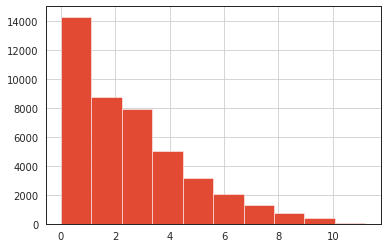

Plotting for column AC 2


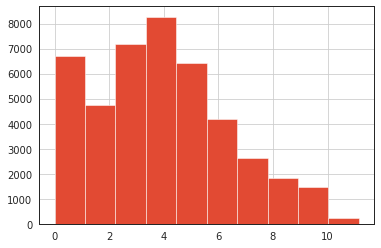

Plotting for column AC 3


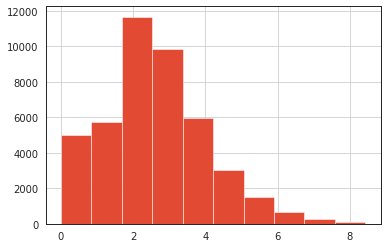

Plotting for column AC 4


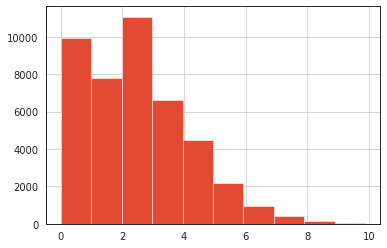

Plotting for column AC 5


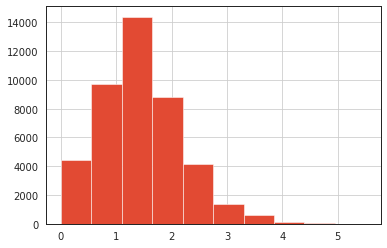

Plotting for column AC 6


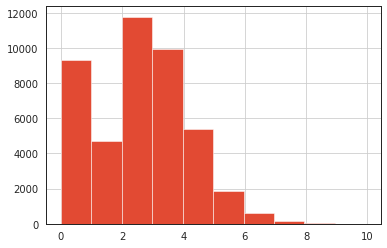

Plotting for column AC 7


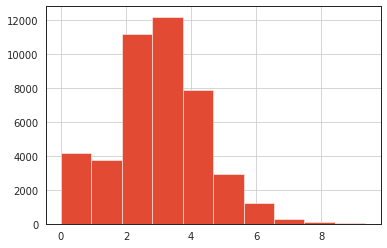

Plotting for column AC 8


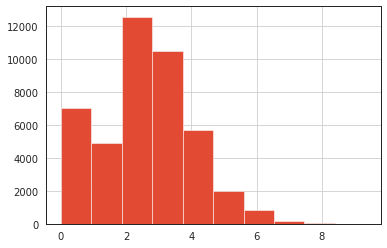

Plotting for column AC 9


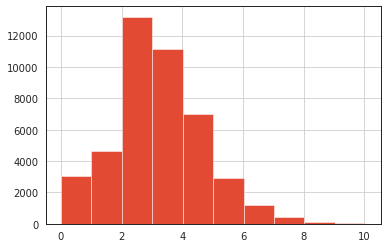

Plotting for column AC 10


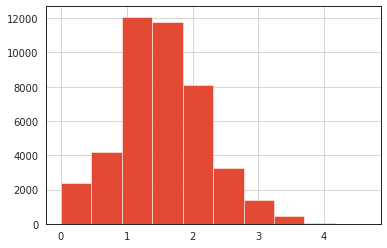

Plotting for column AC 11


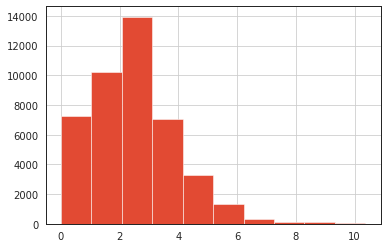

Plotting for column AC 12


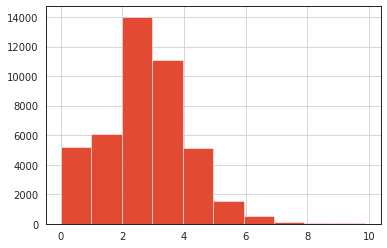

Plotting for column AC 13


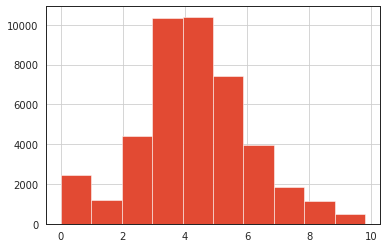

Plotting for column AC 14


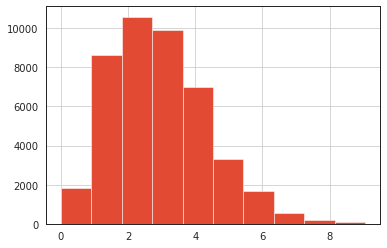

Plotting for column AC 15


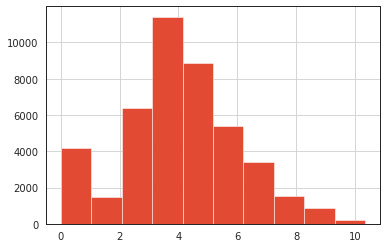

Plotting for column AC 16


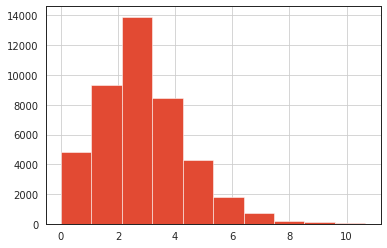

Plotting for column AC 17


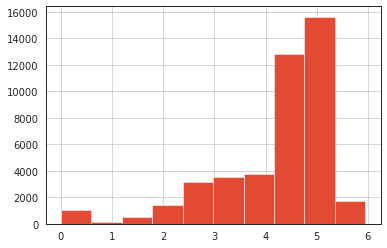

Plotting for column AC 18


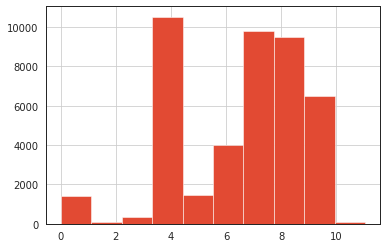

Plotting for column month


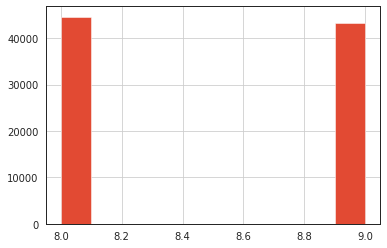

Plotting for column week


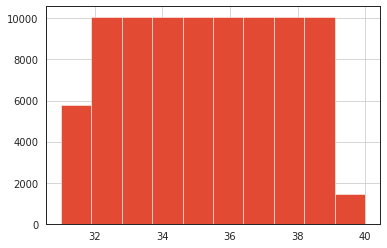

Plotting for column day


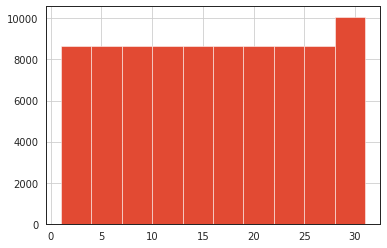

Plotting for column hour


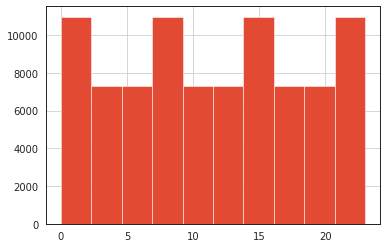

Plotting for column minute


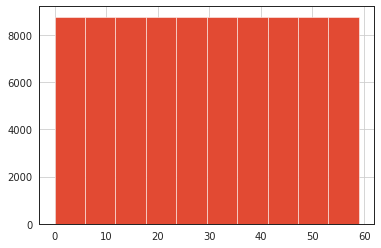

In [39]:
#plotting counts of each column
for col in df.columns:
    hist = df[col].hist(bins=10)
    print("Plotting for column {}".format(col))
    plt.show()

***From above graph we can see the number of times corresponding to each AC power consumption in our dataset. For example- AC 1 has most of the units consumed between 0-2 kWH 14k+ and for AC 6 it has very less count of units consumed between 6-8 kWH say less than 500 times.***

***Checking power consumption pattern with respect to days*** 

In [40]:
#defining function so that we can do it for other AC's as well with repect to days
def visualize_day(X,Y):

  from matplotlib import style

  fig = plt.figure()
  ax1 = plt.subplot2grid((1,1), (0,0))

  style.use('ggplot')

  sns.lineplot(x=X, y=Y, data=df)
  sns.set(rc={'figure.figsize':(15,6)})

  plt.title("Energy consumption of AC")
  plt.xlabel("Day")
  plt.ylabel("Energy in KW")
  plt.grid(True)
  plt.legend()

  for label in ax1.xaxis.get_ticklabels():
    label.set_rotation(90)


  plt.title("Energy Consumption According to day");

No handles with labels found to put in legend.


Consumption of AC 1


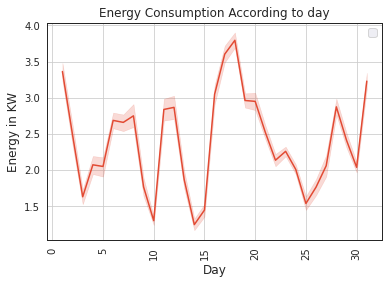

In [41]:
#showing AC 1 power consumption v/s days
visualize_day(df['day'],df['AC 1']);
print("Consumption of AC 1")

No handles with labels found to put in legend.


Consumption of AC 2


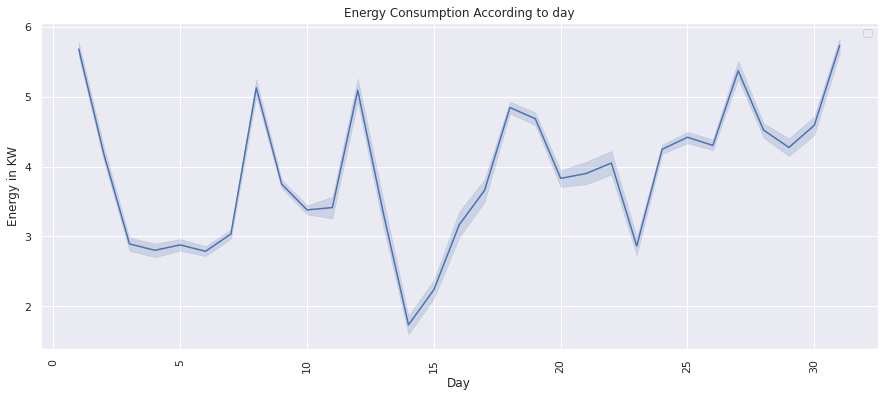

In [42]:
#showing AC 2 power consumption v/s days
visualize_day(df['day'],df['AC 2'])
print("Consumption of AC 2")

No handles with labels found to put in legend.


Consumption of AC 3


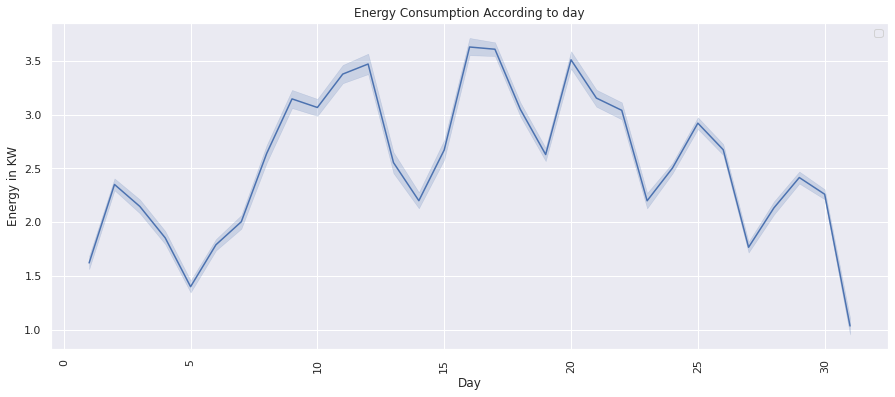

In [43]:
#showing AC 3 power consumption v/s days
visualize_day(df['day'],df['AC 3'])
print("Consumption of AC 3")

No handles with labels found to put in legend.


Consumption of AC 4


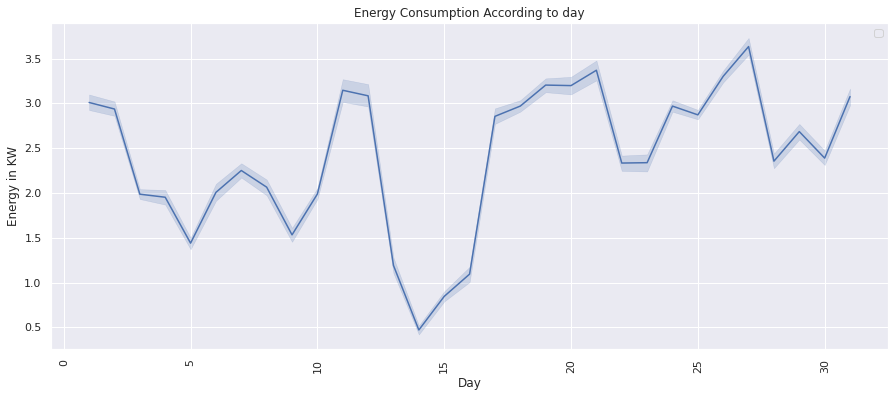

In [44]:
#showing AC 4 power consumption v/s days
visualize_day(df['day'],df['AC 4'])
print("Consumption of AC 4")

No handles with labels found to put in legend.


Consumption of AC 5


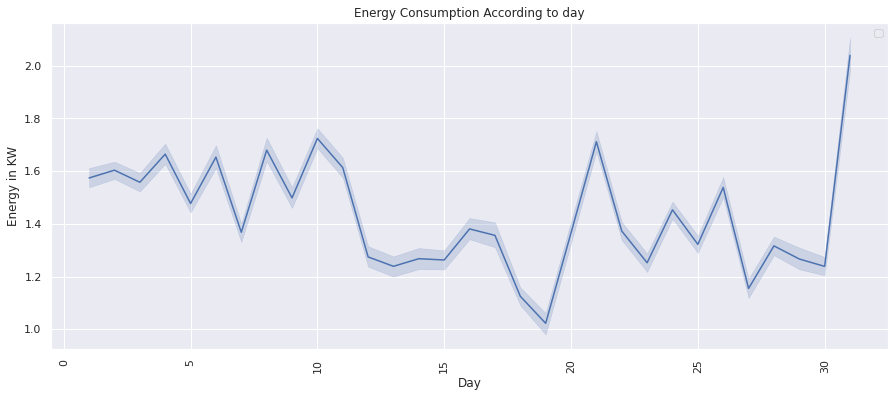

In [45]:
#showing AC 5 power consumption v/s days
visualize_day(df['day'],df['AC 5'])
print("Consumption of AC 5")

No handles with labels found to put in legend.


Consumption of AC 17


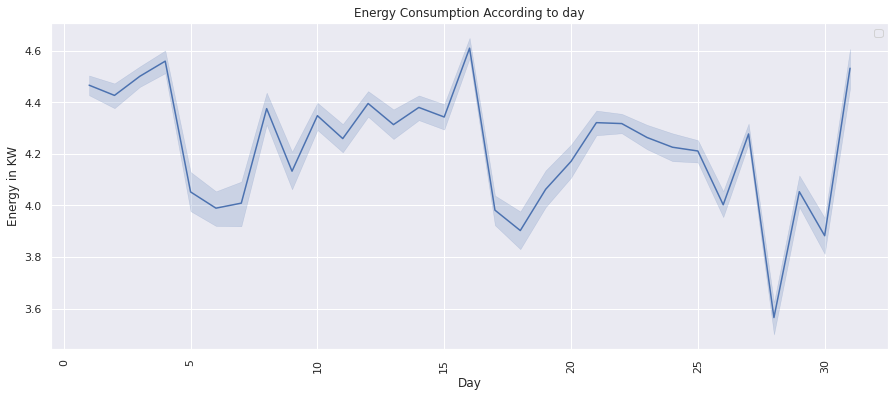

In [46]:
#showing AC 17 power consumption v/s days
visualize_day(df['day'],df['AC 17'])
print("Consumption of AC 17")

No handles with labels found to put in legend.


Consumption of AC 18


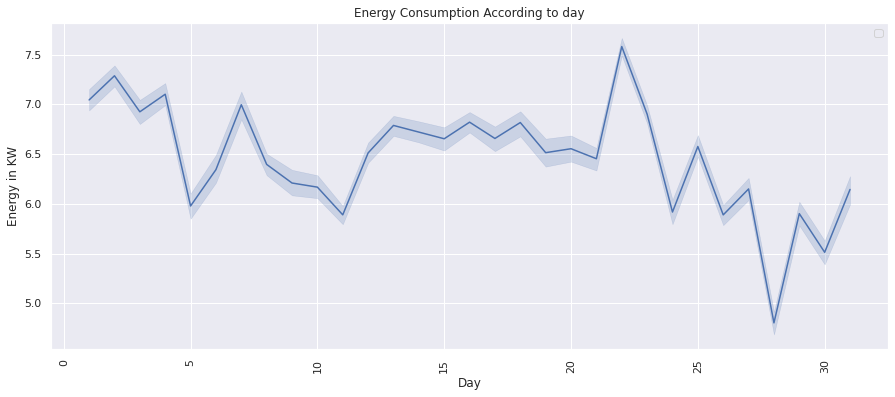

In [47]:
#showing AC 18 power consumption v/s days
visualize_day(df['day'],df['AC 18'])
print("Consumption of AC 18")

**Similarly we can plot for other AC in our dataset. From this there is not that much great information revealed except AC 17 and 18 because there is no such significant difference between power consumption with repsect to days. We'll now move to analysis with repect to hourly consumption.** 

***Checking power consumption pattern with respect to hours*** 

In [48]:
def visualize_hour(X,Y):

  from matplotlib import style

  fig = plt.figure()
  ax1 = plt.subplot2grid((1,1), (0,0))

  style.use('ggplot')

  sns.lineplot(x=X, y=Y, data=df)
  sns.set(rc={'figure.figsize':(15,6)})

  plt.title("Energy consumption ")
  plt.xlabel("Hour")
  plt.ylabel("Energy in KW")
  plt.grid(True)
  plt.legend()

  for label in ax1.xaxis.get_ticklabels():
    label.set_rotation(90)


  plt.title("Energy Consumption According to hour");

No handles with labels found to put in legend.


Consumption of AC 6


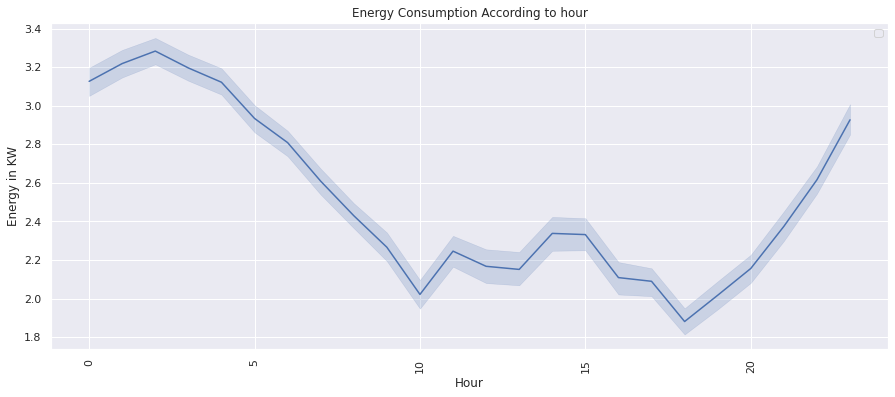

In [49]:
#plotting AC 6 w.r.t hours
visualize_hour(df['hour'],df['AC 6'])
print("Consumption of AC 6")

No handles with labels found to put in legend.


Consumption of AC 10


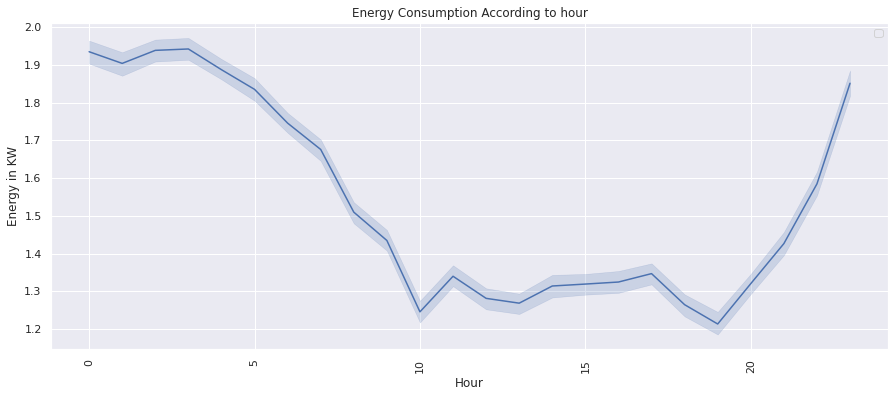

In [50]:
#plotting AC 10 w.r.t hours
visualize_hour(df['hour'],df['AC 10'])
print("Consumption of AC 10")

No handles with labels found to put in legend.


Consumption of AC 1


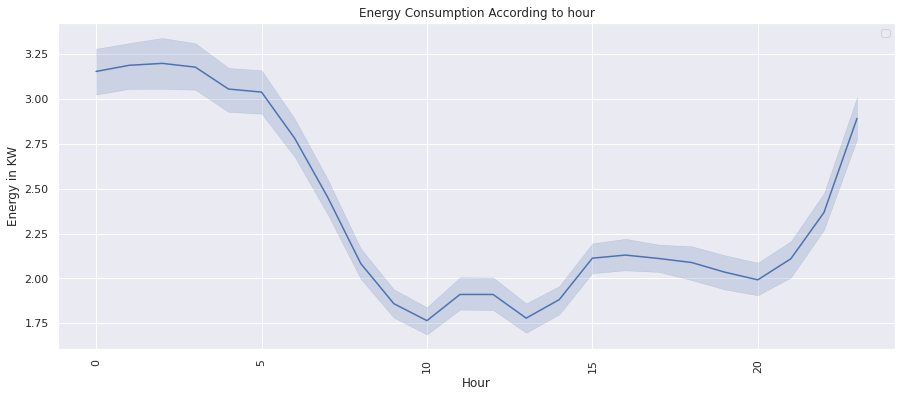

In [51]:
#plotting AC 1 w.r.t hours
visualize_hour(df['hour'],df['AC 1'])
print("Consumption of AC 1")

No handles with labels found to put in legend.


Consumption of AC 8


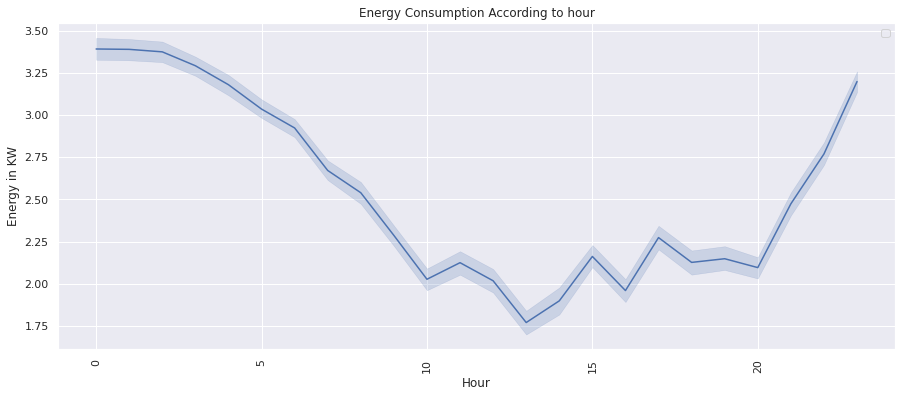

In [52]:
#plotting AC 8 w.r.t hours
visualize_hour(df['hour'],df['AC 8'])
print("Consumption of AC 8")

No handles with labels found to put in legend.


Consumption of AC 17


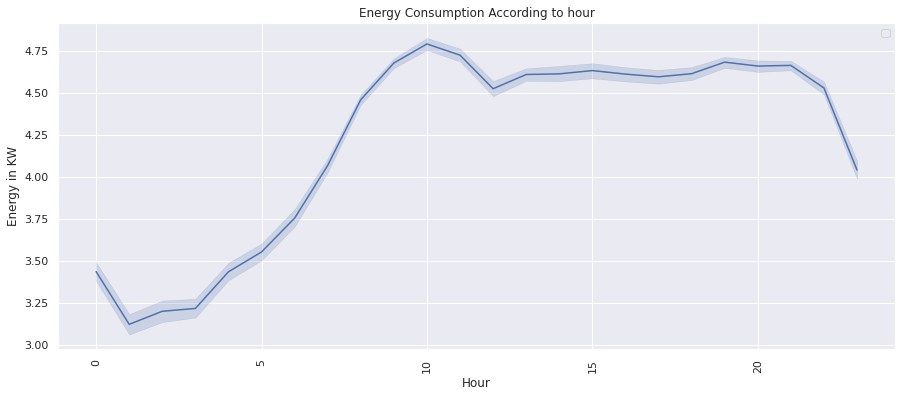

In [53]:
#plotting AC 17 w.r.t hours
visualize_hour(df['hour'],df['AC 17'])
print("Consumption of AC 17")

No handles with labels found to put in legend.


Consumption of AC 18


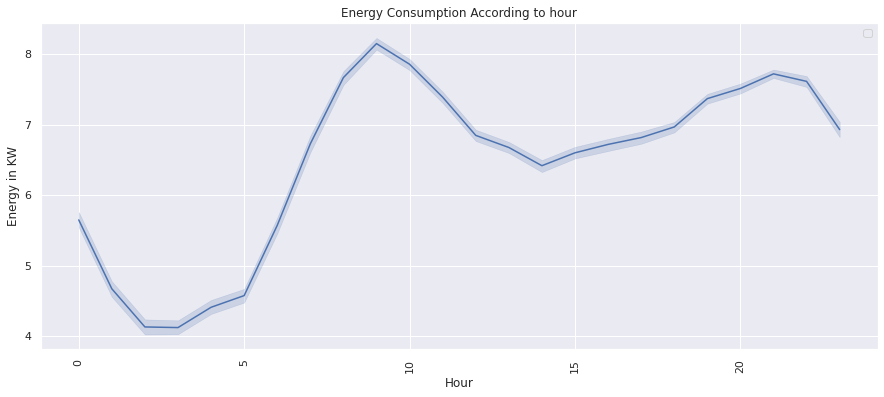

In [54]:
#plotting AC 18 w.r.t hours
visualize_hour(df['hour'],df['AC 18'])
print("Consumption of AC 18")

***Now from the above graphs we can infer that most of the AC are used between 0 to 5 that is in the night unlike AC 17 and AC 18. We can say that both of the ACs are in main area of hotel or the area where ACs are supposed to have maximum usage.*** 

In [55]:
#checking for null values in dataframe
df.isnull().values.any()

True

In [56]:
#creating copy of dataframe
df_nn= df.copy()

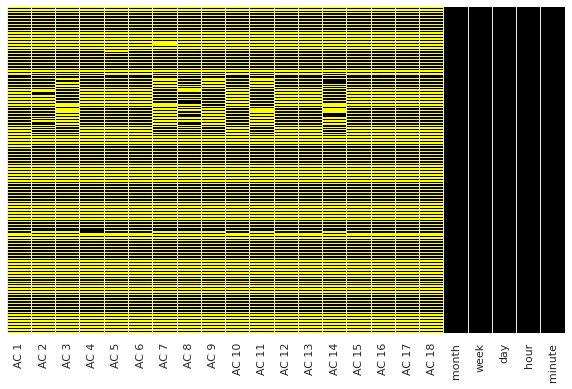

In [57]:
# creating heatmap for null values
plt.figure(figsize=(10,6))
sns.heatmap(df.isnull(),yticklabels= False, cbar= False, cmap= 'gnuplot');

Filling null values with 0 assuming null is OFF. (This could be changed according to subject matter expert) 

In [58]:
#filling null values with 0 
df_nn.fillna(value = 0,
          inplace = True)

In [59]:
#checking presence of null values in our dataframe
df_nn.isnull().values.any()

False

In [60]:
#displaying the datadset after filling null values 
df_nn

,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18,month,week,day,hour,minute
0,7.518632,8.788315,0.000000,0.000000,2.617045,4.079041,2.782276,4.624447,5.222060,2.151238,1.585072,0.560373,3.142941,2.749470,5.417774,4.113460,3.305072,6.735981,8,31,1,0,0
1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8,31,1,0,1
2,7.426114,8.940615,0.000000,0.000000,2.581625,3.781231,2.529366,5.057423,5.349465,2.414715,2.168184,1.818730,3.085110,2.720484,3.302422,3.986483,3.220588,6.379500,8,31,1,0,2
3,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8,31,1,0,3
4,7.052986,9.161103,0.000000,0.000000,2.592095,3.800127,2.332304,6.322521,3.995392,2.237114,3.345624,2.310409,3.132799,2.676861,3.539026,3.797881,3.131560,6.363475,8,31,1,0,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
87835,0.000000,6.122385,2.192198,2.083315,1.046250,0.000000,3.668421,3.006311,3.614301,1.860847,5.019769,3.154221,3.648026,2.439526,4.062719,1.854352,3.027539,7.259989,9,40,30,23,55
87836,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,9,40,30,23,56
87837,1.209176,6.152532,2.211421,0.000000,1.448103,0.000000,3.151248,2.871690,3.417942,2.185493,5.174168,2.772349,3.786657,2.060023,4.057525,1.870886,2.991946,7.134647,9,40,30,23,57
87838,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,9,40,30,23,58


In [61]:
df_nn.tail()

,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18,month,week,day,hour,minute
87835,0.000000,6.122385,2.192198,2.083315,1.046250,0.000000,3.668421,3.006311,3.614301,1.860847,5.019769,3.154221,3.648026,2.439526,4.062719,1.854352,3.027539,7.259989,9,40,30,23,55
87836,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,9,40,30,23,56
87837,1.209176,6.152532,2.211421,0.000000,1.448103,0.000000,3.151248,2.871690,3.417942,2.185493,5.174168,2.772349,3.786657,2.060023,4.057525,1.870886,2.991946,7.134647,9,40,30,23,57
87838,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,9,40,30,23,58
87839,1.430442,6.078281,1.891162,0.000000,1.577491,4.364239,3.126339,3.287224,3.986978,2.013912,4.821829,3.363855,3.380110,1.949240,4.026304,1.862166,3.009434,7.179719,9,40,30,23,59


In [62]:
#creating new dataset
dfml= df_nn.drop(['day','week', 'month','hour','minute'], axis=1)

In [63]:
dfml.head()

,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18
0,7.518632,8.788315,0.0,0.0,2.617045,4.079041,2.782276,4.624447,5.222060,2.151238,1.585072,0.560373,3.142941,2.749470,5.417774,4.113460,3.305072,6.735981
1,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
2,7.426114,8.940615,0.0,0.0,2.581625,3.781231,2.529366,5.057423,5.349465,2.414715,2.168184,1.818730,3.085110,2.720484,3.302422,3.986483,3.220588,6.379500
3,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,7.052986,9.161103,0.0,0.0,2.592095,3.800127,2.332304,6.322521,3.995392,2.237114,3.345624,2.310409,3.132799,2.676861,3.539026,3.797881,3.131560,6.363475


In [64]:
#summing up total power consumption 
df_nn.loc[:,'Total_consumption'] = dfml.sum(numeric_only=True, axis=1)

In [65]:
df_nn.head(4)

,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18,month,week,day,hour,minute,Total_consumption
0,7.518632,8.788315,0.0,0.0,2.617045,4.079041,2.782276,4.624447,5.222060,2.151238,1.585072,0.560373,3.142941,2.749470,5.417774,4.113460,3.305072,6.735981,8,31,1,0,0,65.393197
1,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8,31,1,0,1,0.000000
2,7.426114,8.940615,0.0,0.0,2.581625,3.781231,2.529366,5.057423,5.349465,2.414715,2.168184,1.818730,3.085110,2.720484,3.302422,3.986483,3.220588,6.379500,8,31,1,0,2,64.762056
3,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8,31,1,0,3,0.000000


In [66]:
#statistical desciption of dataset
df_nn.describe()

,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18,month,week,day,hour,minute,Total_consumption
count,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000
mean,1.183942,1.925241,1.278153,1.191689,0.707548,1.253249,1.482263,1.268088,1.582548,0.765144,1.196223,1.343457,2.130153,1.451122,2.013698,1.393331,2.099595,3.216844,8.491803,35.278689,15.754098,11.500000,29.500000,27.482289
std,1.998665,2.639219,1.658396,1.744067,0.893445,1.717361,1.816867,1.658347,1.920068,0.908466,1.627471,1.687689,2.505497,1.783365,2.473354,1.801074,2.253949,3.621988,0.499936,2.535863,8.807007,6.922226,17.318201,26.912587
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8.000000,31.000000,1.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8.000000,33.000000,8.000000,5.750000,14.750000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8.000000,35.000000,16.000000,11.500000,29.500000,24.272520
75%,2.081188,3.779844,2.480290,2.300950,1.376693,2.656701,2.996157,2.601819,3.072061,1.500432,2.342870,2.719761,4.208258,2.778634,3.991734,2.665481,4.607963,7.120772,9.000000,37.000000,23.000000,17.250000,44.250000,52.128510
max,11.194789,11.147141,8.430909,9.879500,5.495358,9.929291,9.356776,9.331506,10.026747,4.625030,10.363151,9.887306,9.796393,9.054969,10.349998,10.654430,5.950261,11.040031,9.000000,40.000000,31.000000,23.000000,59.000000,130.064581


In [67]:
#showing bottom 5 rows in dataset
df_nn.tail()

,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18,month,week,day,hour,minute,Total_consumption
87835,0.000000,6.122385,2.192198,2.083315,1.046250,0.000000,3.668421,3.006311,3.614301,1.860847,5.019769,3.154221,3.648026,2.439526,4.062719,1.854352,3.027539,7.259989,9,40,30,23,55,54.060166
87836,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,9,40,30,23,56,0.000000
87837,1.209176,6.152532,2.211421,0.000000,1.448103,0.000000,3.151248,2.871690,3.417942,2.185493,5.174168,2.772349,3.786657,2.060023,4.057525,1.870886,2.991946,7.134647,9,40,30,23,57,52.495807
87838,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,9,40,30,23,58,0.000000
87839,1.430442,6.078281,1.891162,0.000000,1.577491,4.364239,3.126339,3.287224,3.986978,2.013912,4.821829,3.363855,3.380110,1.949240,4.026304,1.862166,3.009434,7.179719,9,40,30,23,59,57.348726


In [68]:
#Max Power consumption details of AC
df_nn[df_nn.Total_consumption==df_nn.Total_consumption.max()]

,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18,month,week,day,hour,minute,Total_consumption
67694,7.167545,9.762423,5.05183,9.63185,3.644817,7.62265,5.352187,8.507614,7.490126,3.597032,10.094864,9.093901,9.163816,8.412095,8.914057,6.416979,3.808862,6.331931,9,38,17,0,14,130.064581


In [69]:
#retreiving the row with specific index 
df.loc[67694:67694]

,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18,month,week,day,hour,minute
67694,7.167545,9.762423,5.05183,9.63185,3.644817,7.62265,5.352187,8.507614,7.490126,3.597032,10.094864,9.093901,9.163816,8.412095,8.914057,6.416979,3.808862,6.331931,9,38,17,0,14


***The above row shows the maximum power consumption with all of its attribute showing that maximum power consumption was on 17 Spetember 2019 around 12:14 a.m.*** 

In [112]:
#dropping values to create sum for each column so that we can analyse total consumption in kWH(units) for each AC
s=df_nn.drop(['hour','month','day','week','minute','Total_consumption'],axis=1)

In [71]:
#perfroming sum and storing values 
sum=s.sum(axis = 0, skipna = True)

In [72]:
#sorting values
t_unit=sum.sort_values( ascending=True)

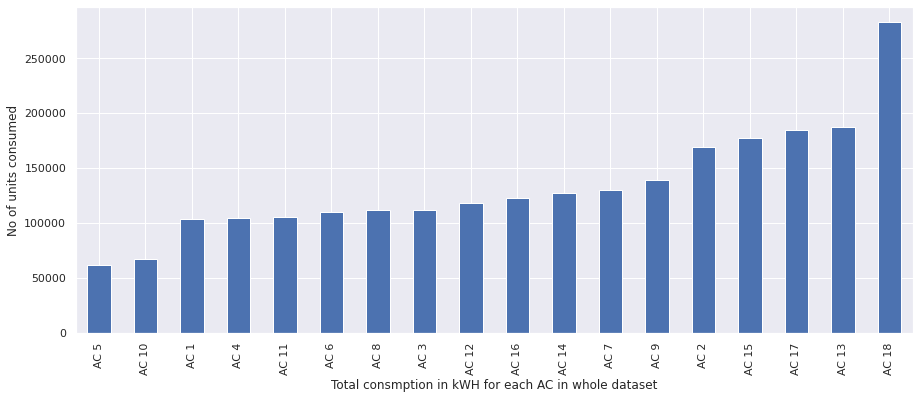

In [73]:
#plotting summation of units consumed
t_unit.plot(kind='bar',xlabel='Total consmption in kWH for each AC in whole dataset',ylabel= 'No of units consumed');

***From the above graph we can see that AC 5 is the least and AC 18 is the most used AC.***

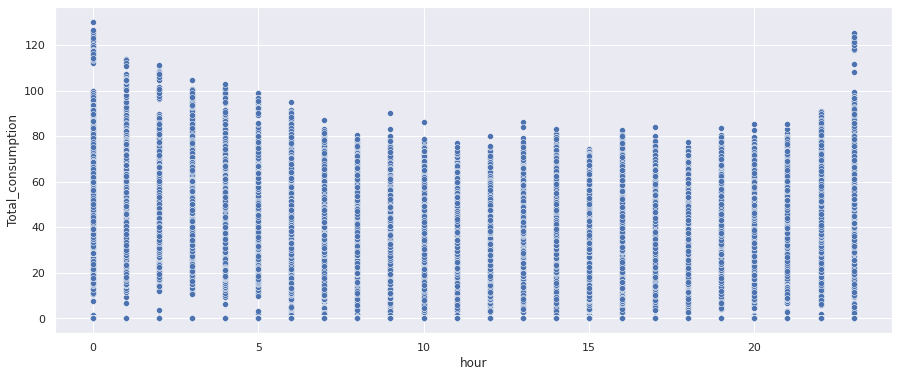

In [74]:
#plotting hour and total consumption relation
sns.scatterplot('hour','Total_consumption', data=df_nn);


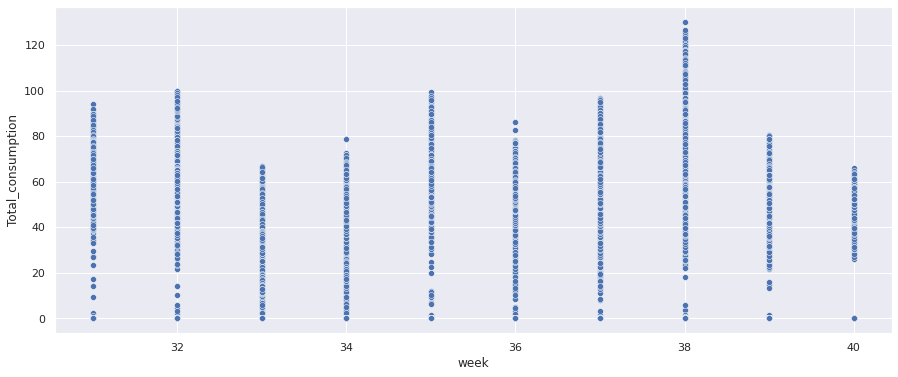

In [75]:
#plotting week and total consumption relation
sns.scatterplot('week','Total_consumption', data=df_nn);

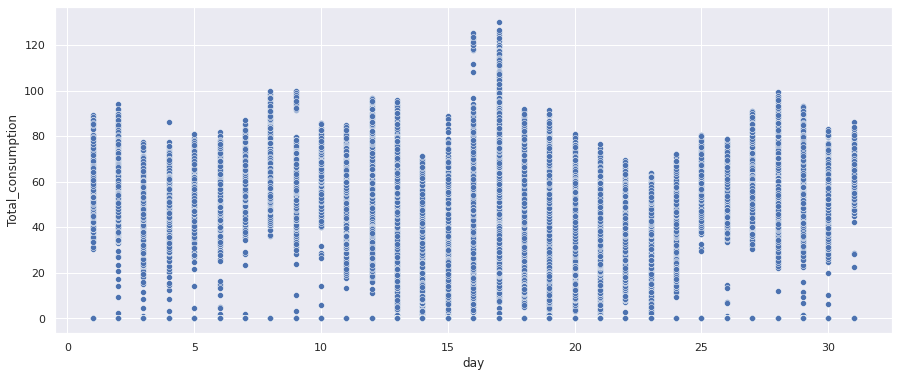

In [76]:
#plotting day and total consumption relation
sns.scatterplot('day','Total_consumption', data=df_nn);

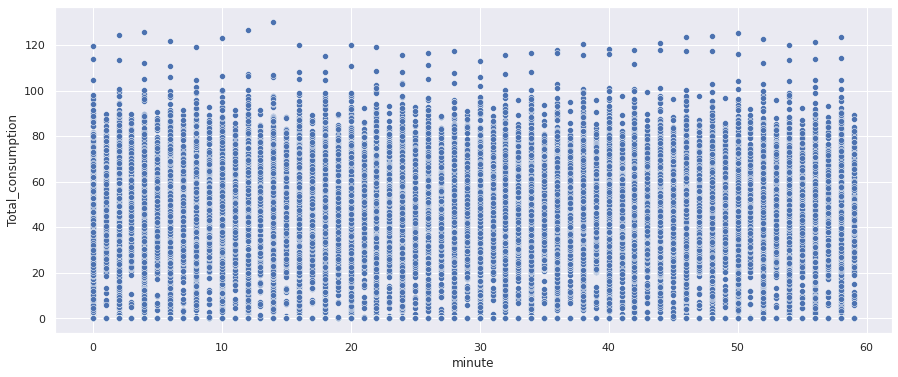

In [77]:
#plotting min and total consumption relation
sns.scatterplot('minute','Total_consumption', data=df_nn);

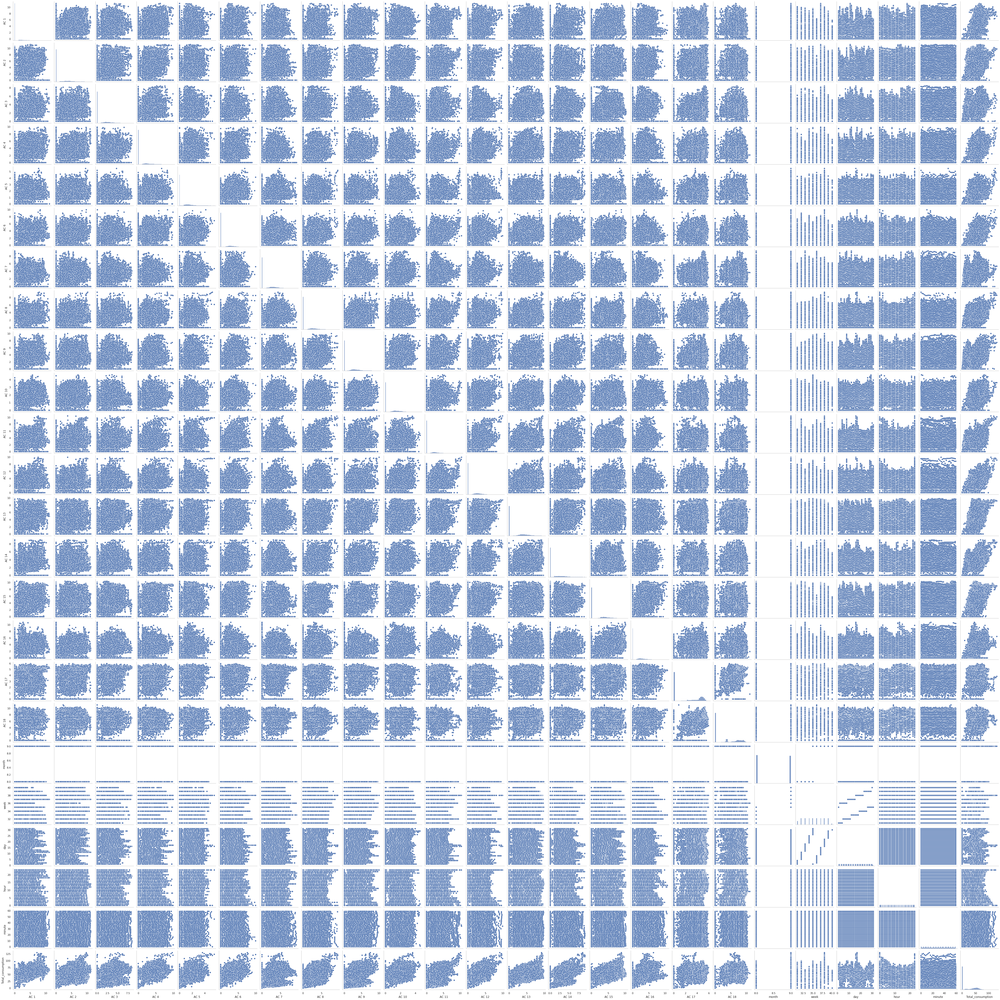

In [78]:
#pairplot for dataset
sns.set_style("whitegrid", {'axes.grid' : False})
pp=sns.pairplot(df_nn);

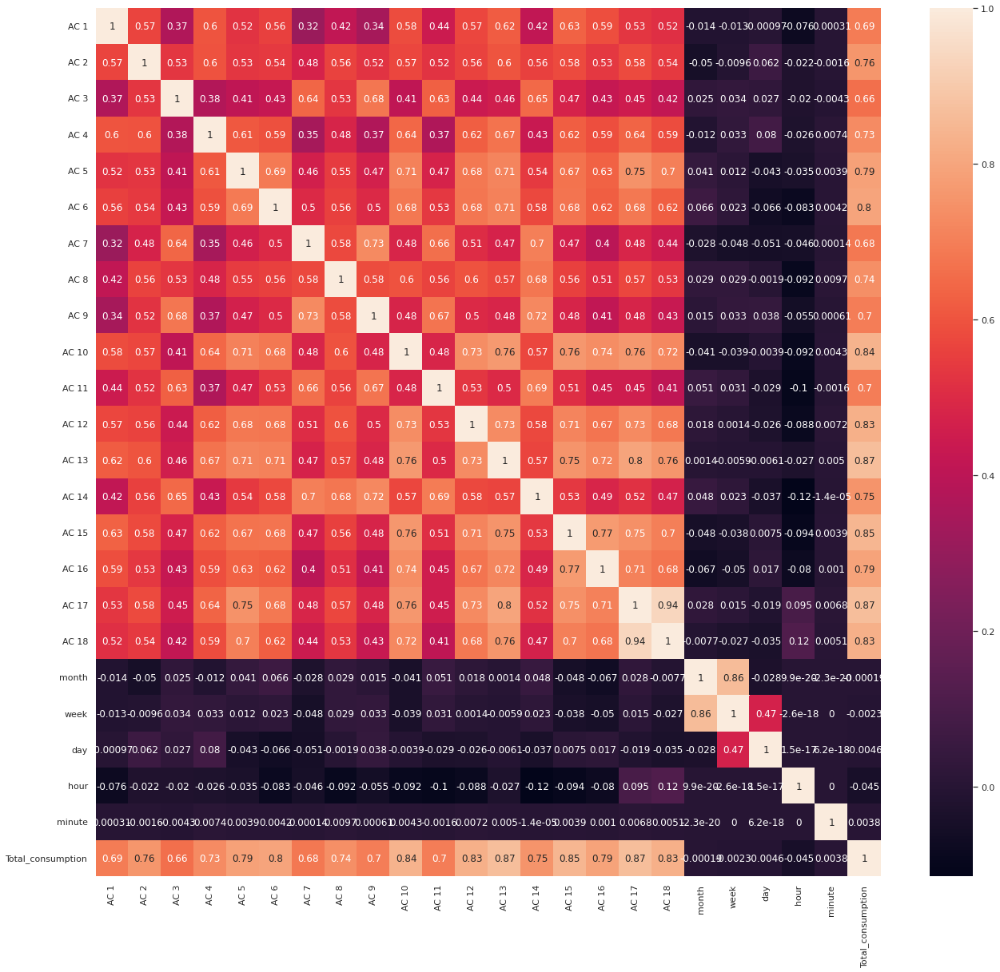

In [79]:
#plotting correlation heatmap for to get more clear picture of correlation
plt.subplots(figsize=(22,20))
sns.heatmap(df_nn.corr(), annot=True);

***Again from above heatmap now its pretty much clear that AC 17 and 18 are highly correlated. Also we can see that AC 17  is also higly correlated with total consumption (in kWH).*** 

/usr/local/lib/python3.7/dist-packages/seaborn/categorical.py:3717: UserWarning: The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.
  warnings.warn(msg)
/usr/local/lib/python3.7/dist-packages/seaborn/categorical.py:3723: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


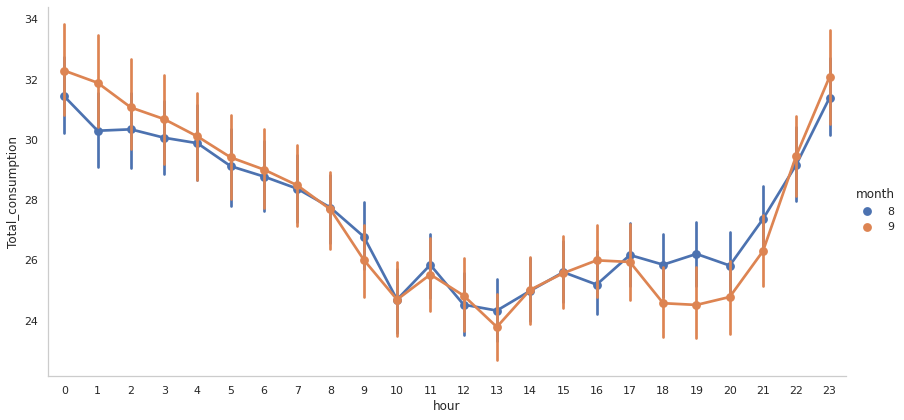

In [81]:
#plotting consumption for both month corresponding to hours
sns.factorplot(data = df_nn, x = "hour", y = "Total_consumption", hue = "month",  size=6, aspect=2);

/usr/local/lib/python3.7/dist-packages/seaborn/categorical.py:3717: UserWarning: The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.
  warnings.warn(msg)
/usr/local/lib/python3.7/dist-packages/seaborn/categorical.py:3723: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


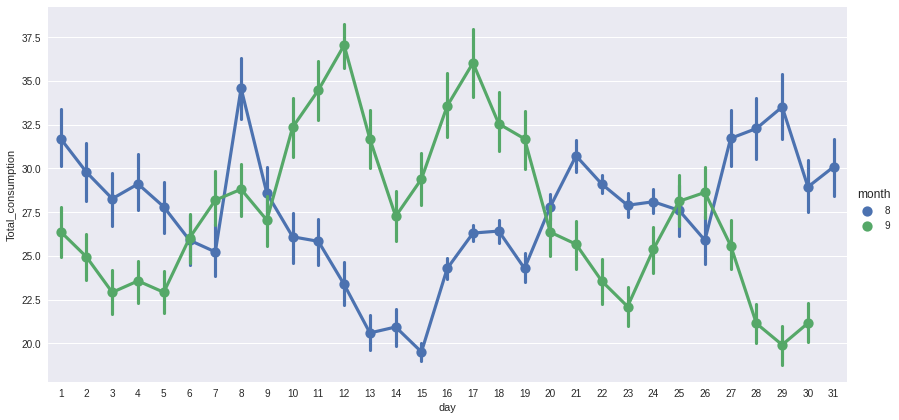

In [113]:
#plotting consumption for both month corresponding to day
sns.factorplot(data = df_nn, x = "day", y = "Total_consumption", hue = "month",  size=6, aspect=2);

/usr/local/lib/python3.7/dist-packages/seaborn/categorical.py:3717: UserWarning: The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.
  warnings.warn(msg)
/usr/local/lib/python3.7/dist-packages/seaborn/categorical.py:3723: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


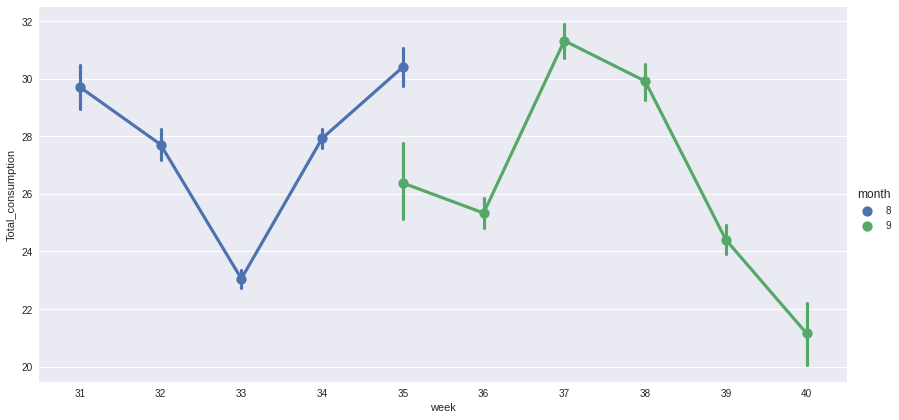

In [114]:
#plotting consumption for both month corresponding to week
sns.factorplot(data = df_nn, x = "week", y = "Total_consumption", hue = "month",  size=6, aspect=2);

/usr/local/lib/python3.7/dist-packages/seaborn/categorical.py:3717: UserWarning: The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.
  warnings.warn(msg)
/usr/local/lib/python3.7/dist-packages/seaborn/categorical.py:3723: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


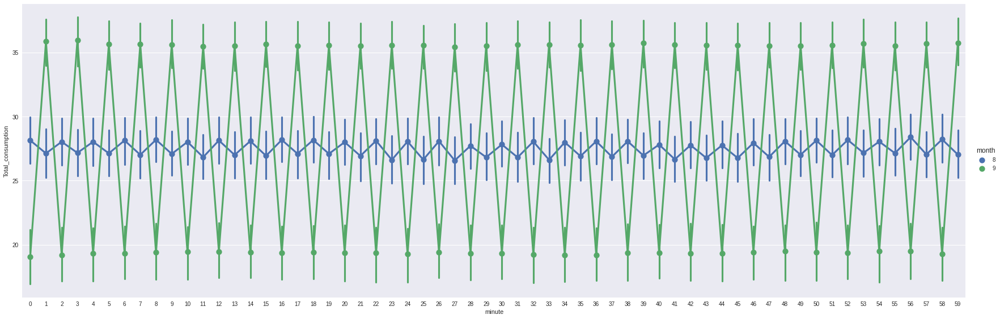

In [120]:
#plotting consumption for both month corresponding to minutes
sns.factorplot(data = df_nn, x = "minute", y = "Total_consumption", hue = "month",  size=8, aspect=3);

#**Implementing Machine Learning models**


In [82]:
#separating dataset into X and y
X = df_nn.drop(['Total_consumption'] , axis = 1)
y= df_nn.Total_consumption

In [83]:
#displaying head of X
X.head()

,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18,month,week,day,hour,minute
0,7.518632,8.788315,0.0,0.0,2.617045,4.079041,2.782276,4.624447,5.222060,2.151238,1.585072,0.560373,3.142941,2.749470,5.417774,4.113460,3.305072,6.735981,8,31,1,0,0
1,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8,31,1,0,1
2,7.426114,8.940615,0.0,0.0,2.581625,3.781231,2.529366,5.057423,5.349465,2.414715,2.168184,1.818730,3.085110,2.720484,3.302422,3.986483,3.220588,6.379500,8,31,1,0,2
3,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8,31,1,0,3
4,7.052986,9.161103,0.0,0.0,2.592095,3.800127,2.332304,6.322521,3.995392,2.237114,3.345624,2.310409,3.132799,2.676861,3.539026,3.797881,3.131560,6.363475,8,31,1,0,4


In [84]:
#importing libraries
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.preprocessing import MinMaxScaler

In [85]:
#performing test train split
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.3, random_state=0)

In [86]:
# Transforming data
scaler = MinMaxScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

In [87]:
# Fitting Linear Regression on Training set
regressor = LinearRegression()
regressor.fit(X_train, y_train)

LinearRegression()

In [88]:
regressor.intercept_

-3.552713678800501e-15

In [89]:
regressor.coef_

array([1.10286660e+01, 1.11288418e+01, 8.38532031e+00, 9.84914355e+00,
       5.49535840e+00, 9.66642383e+00, 9.35677637e+00, 9.33150586e+00,
       9.74940723e+00, 4.56101953e+00, 1.03444268e+01, 9.70852637e+00,
       9.79639258e+00, 9.05172949e+00, 1.03499980e+01, 1.05272012e+01,
       5.94530176e+00, 1.10400313e+01, 6.89448498e-14, 4.87943019e-14,
       2.35922393e-16, 1.79856130e-14, 6.00214323e-16])

In [90]:
#predicting total consumption
y_pred_train = regressor.predict(X_train)

In [91]:
# Predicting the Test set results
y_pred = regressor.predict(X_test)

In [92]:
mean_squared_error(y_test, y_pred)

1.5544541189849718e-26

In [93]:
#displaying training score
train_score_1=regressor.score(X_train,y_train)
train_score_1

1.0

In [94]:
#displaying testing score 
test_score_1=regressor.score(X_test,y_test)
test_score_1

1.0

In [95]:
import statsmodels.api as sm
X = sm.add_constant(X) ## let's add an intercept (beta_0) to our model
model = sm.OLS(y, X).fit() ## sm.OLS(output, input)
predictions = model.predict(X)

# Print out the statistics
model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:      Total_consumption   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 4.922e+31
Date:                Sat, 20 Nov 2021   Prob (F-statistic):               0.00
Time:                        08:10:28   Log-Likelihood:             2.4289e+06
No. Observations:               87840   AIC:                        -4.858e+06
Df Residuals:                   87816   BIC:                        -4.858e+06
Df Model:                          23                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       5.729e-13   1.96e-14     29.283      0.000    5.35e-13    6.11e-13
AC 1           1.0000    5.9e-16    1.7e+15      0.000       1.000       1.000
AC 2           1.0000   4.56e-16   2.19e+15      0.000       1.000       1.000
AC 3           1.0000   7.48e-16   1.34e+15      0.000       1.000       1.000
AC 4           1.0000   7.16e-16    1.4e+15      0.000       1.000       1.000
AC 5           1.0000   1.53e-15   6.54e+14      0.000       1.000       1.000
AC 6           1.0000    7.8e-16   1.28e+15      0.000       1.000       1.000
AC 7           1.0000   7.38e-16   1.35e+15      0.000       1.000       1.000
AC 8           1.0000   7.38e-16   1.36e+15      0.000       1.000       1.000
AC 9           1.0000   7.25e-16   1.38e+15      0.000       1.000       1.000
AC 10          1.0000   1.74e-15   5.76e+14      0.000       1.000       1.000
AC 11          1.0000   7.96e-16   1.26e+15      0.000       1.000       1.000
AC 12          1.0000   8.44e-16   1.18e+15      0.000       1.000       1.000
AC 13          1.0000   6.48e-16   1.54e+15      0.000       1.000       1.000
AC 14          1.0000   8.25e-16   1.21e+15      0.000       1.000       1.000
AC 15          1.0000   6.37e-16   1.57e+15      0.000       1.000       1.000
AC 16          1.0000   7.86e-16   1.27e+15      0.000       1.000       1.000
AC 17          1.0000   1.19e-15   8.37e+14      0.000       1.000       1.000
AC 18          1.0000   6.42e-16   1.56e+15      0.000       1.000       1.000
month      -6.377e-13   1.26e-14    -50.514      0.000   -6.62e-13   -6.13e-13
week        1.414e-13   2.81e-15     50.246      0.000    1.36e-13    1.47e-13
day        -1.682e-14    4.1e-16    -41.018      0.000   -1.76e-14    -1.6e-14
hour       -1.214e-15   1.24e-16     -9.793      0.000   -1.46e-15   -9.71e-16
minute     -1.616e-15   4.62e-17    -34.980      0.000   -1.71e-15   -1.53e-15
==============================================================================
Omnibus:                     5189.744   Durbin-Watson:                   0.263
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             6337.950
Skew:                           0.598   Prob(JB):                         0.00
Kurtosis:                       3.551   Cond. No.                     1.46e+03
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 1.46e+03. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

**Implementing Random Forest Regressor**

In [96]:
#importing RF
from sklearn.ensemble import RandomForestRegressor

In [97]:
#%%time
rdf = RandomForestRegressor(n_estimators=80,min_samples_split=2, min_samples_leaf=1,max_depth=None,n_jobs=-1)
rdfreg = rdf.fit(X_train, y_train)

In [98]:
#definig function for rsme and mape
from math import sqrt
def rmse(x, y):
    return sqrt(mean_squared_error(x, y))

# definte MAPE function
def mape(x, y): 
    return np.mean(np.abs((x - y) / x)) * 100


In [99]:
#displaying score
train_score_5=rdfreg.score(X_train, y_train)
test_score_5=rdfreg.score(X_test, y_test)

print("Regresion Model Score" , ":" , train_score_5 , "," ,
      "Test Score" ,":" , test_score_5)   

y_predicted_2 = rdfreg.predict(X_train)
y_test_predicted_2 = rdfreg.predict(X_test)

print("Training RMSE", ":", rmse(y_train, y_predicted_2),
      "Testing RMSE", ":", rmse(y_test, y_test_predicted_2))
print("Training MAPE", ":", mape(y_train, y_predicted_2),
      "Testing MAPE", ":", mape(y_test, y_test_predicted_2))

Regresion Model Score : 0.999314830676954 , Test Score : 0.9953548273157118
Training RMSE : 0.7029493298457599 Testing RMSE : 1.8433319298381472
Training MAPE : 1.5451127520861663 Testing MAPE : 4.211630977142569


In [100]:
#storing all observations for analysis
rf_prd = y_test_predicted_2
rf_real = y_test
dataset_rf = pd.DataFrame({'Real':rf_real,'PredictedRF':rf_prd})

In [101]:
#storing absolute diffrences between actual sales price and predicted
dataset_rf['diff']=(dataset_rf['Real']-dataset_rf['PredictedRF']).abs()

In [102]:
 # taking 4 sample
dataset_rf.sample(4)

,Real,PredictedRF,diff
28421,44.377517,44.918054,0.540537
70664,82.278583,81.098455,1.180128
62789,0.000000,0.000000,0.000000
75733,41.036185,40.438730,0.597455


In [103]:
#Statistical description of our predictions and actual values 
dataset_rf.describe()

,Real,PredictedRF,diff
count,26352.000000,26352.000000,26352.000000
mean,27.502360,27.487333,1.021426
std,27.046486,26.837216,1.534487
min,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000
50%,24.030513,24.224228,0.296720
75%,52.142275,52.324039,1.537632
max,125.088011,123.722907,16.312815


***Therefore we got MAPE as 4.2% but above dataframe can also be observed to analyse how far off we are from our actual prediction.***

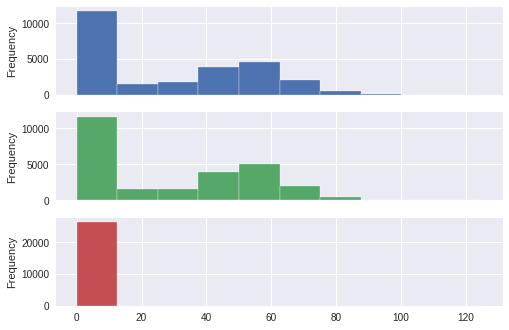

In [104]:
#plotting the actual,predicted & difference of total consumption
plt.style.use('seaborn')
dataset_rf.plot.hist(subplots=True, legend=False);

In [106]:
rdfreg.feature_importances_

array([2.39375007e-02, 1.79289660e-02, 3.13887654e-03, 3.12646808e-03,
       5.69068211e-04, 3.91019289e-03, 6.41647623e-03, 2.29149152e-03,
       3.89840262e-03, 1.29683043e-03, 3.90427214e-02, 1.89978689e-03,
       1.54556309e-02, 4.07140371e-02, 5.46311513e-03, 3.85611039e-03,
       8.23054876e-01, 2.04136192e-03, 4.99458170e-05, 4.43392433e-04,
       6.04295569e-04, 5.74033955e-04, 2.86418925e-04])

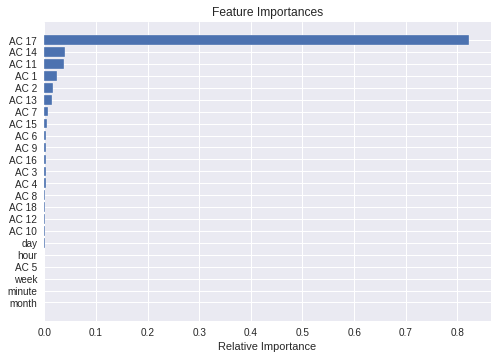

In [107]:
#implementing feature importance from random forest 
features = df_nn.columns
importances = rdfreg.feature_importances_
indices = np.argsort(importances)

plt.title('Feature Importances')
plt.barh(range(len(indices)), importances[indices], color='b', align='center')
plt.yticks(range(len(indices)), [features[i] for i in indices])
plt.xlabel('Relative Importance')
plt.show()

***From above we can see that AC 17 is contributing the most in prediciting the total consumption of all ACs.*** 

***We can also implement Time series forecasting using LSTM RNN to predict future power consumption in hotel.***

In [108]:
#taking 80 % of data  to train and 20 for test
n=80
X_train=df_nn.head(int(len(df)*(n/100)))
n=20
X_test = df_nn.tail(int(len(df)*(n/100)))

In [109]:
X_train

,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18,month,week,day,hour,minute,Total_consumption
0,7.518632,8.788315,0.000000,0.000000,2.617045,4.079041,2.782276,4.624447,5.222060,2.151238,1.585072,0.560373,3.142941,2.749470,5.417774,4.113460,3.305072,6.735981,8,31,1,0,0,65.393197
1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8,31,1,0,1,0.000000
2,7.426114,8.940615,0.000000,0.000000,2.581625,3.781231,2.529366,5.057423,5.349465,2.414715,2.168184,1.818730,3.085110,2.720484,3.302422,3.986483,3.220588,6.379500,8,31,1,0,2,64.762056
3,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8,31,1,0,3,0.000000
4,7.052986,9.161103,0.000000,0.000000,2.592095,3.800127,2.332304,6.322521,3.995392,2.237114,3.345624,2.310409,3.132799,2.676861,3.539026,3.797881,3.131560,6.363475,8,31,1,0,4,65.791277
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
70267,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,9,38,18,19,7,0.000000
70268,6.282862,2.859510,3.374921,1.438226,2.379380,2.764511,2.227375,2.011935,2.451396,0.000000,2.509505,1.413587,4.328263,1.739439,5.301056,1.620436,2.960574,4.544328,9,38,18,19,8,50.207304
70269,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,9,38,18,19,9,0.000000
70270,5.336668,2.764639,3.322667,1.532548,2.026063,2.445524,1.994016,1.867795,2.450145,0.000000,2.526203,1.391372,4.478763,1.736052,5.327742,2.145558,3.056340,4.859046,9,38,18,19,10,49.261141


In [110]:
X_test

,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18,month,week,day,hour,minute,Total_consumption
70272,5.202165,2.751138,3.324324,2.283375,1.876607,2.152819,1.766188,1.276373,2.460459,0.822251,2.477031,1.376468,4.814248,1.715996,5.549653,2.385803,3.251012,5.085424,9,38,18,19,12,50.571333
70273,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,9,38,18,19,13,0.000000
70274,4.051679,4.052900,3.686401,2.407022,1.662897,2.006900,2.397945,1.264008,2.449377,1.133785,2.500390,1.375253,4.789873,1.730402,5.432163,2.374127,3.564153,5.521962,9,38,18,19,14,52.401237
70275,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,9,38,18,19,15,0.000000
70276,3.945604,4.440537,3.792257,2.356178,1.132067,2.060802,2.736060,1.183770,1.817642,1.445870,2.197645,1.695669,4.858587,2.214407,5.451869,2.384152,3.816156,5.918839,9,38,18,19,16,53.448113
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
87835,0.000000,6.122385,2.192198,2.083315,1.046250,0.000000,3.668421,3.006311,3.614301,1.860847,5.019769,3.154221,3.648026,2.439526,4.062719,1.854352,3.027539,7.259989,9,40,30,23,55,54.060166
87836,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,9,40,30,23,56,0.000000
87837,1.209176,6.152532,2.211421,0.000000,1.448103,0.000000,3.151248,2.871690,3.417942,2.185493,5.174168,2.772349,3.786657,2.060023,4.057525,1.870886,2.991946,7.134647,9,40,30,23,57,52.495807
87838,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,9,40,30,23,58,0.000000


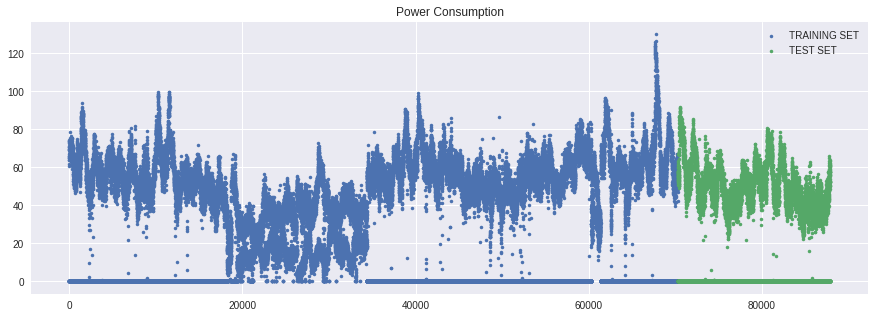

In [111]:
(X_train.rename(columns={'Total_consumption': 'TRAINING SET'})).append(X_test.rename(columns={'Total_consumption': 'TEST SET'}), sort = False)[['TRAINING SET','TEST SET']].plot(style='.', figsize = (15,5), title = "Power Consumption");

***By simply converting dataframe with repect to Time series analysis we can use DARTS library or RNN to predict future power consumption of ACs.***